In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import numpy as np
from torchvision import transforms
from datasets import load_dataset
from PIL import Image
from torch.utils.data import Dataset
from datasets import load_dataset

from vqvae import VQVAE

/usr/local/lib/python3.10/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [3]:
class ImageDataset(Dataset):
    def __init__(self, hf_dataset, transform=None):
        self.dataset = hf_dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]

        if isinstance(item['image'], dict):
            image = item['image']['bytes']
            image = Image.open(io.BytesIO(image))
        elif isinstance(item['image'], bytes):
            image = Image.open(io.BytesIO(item['image']))
        else:
            image = item['image']
            
        if image.mode != 'RGB':
            image = image.convert('RGB')
            
        if self.transform:
            image = self.transform(image)

        return image, item["genre"], idx

In [4]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

hf_dataset = load_dataset("Artificio/WikiArt_Full", split="train")

dataset = ImageDataset(hf_dataset, transform)

In [5]:
data_loader = DataLoader(
    dataset,
    batch_size=64,
    num_workers=4,
    pin_memory=True
)

In [6]:
model = VQVAE().to(device)

model.load_state_dict(torch.load(f"./models/best_model.pth", weights_only=True))

<All keys matched successfully>

In [7]:
with torch.no_grad():
    for data, styles, filenames in data_loader:
        print(styles, filenames)
        break

['cityscape', 'figurative', 'genre painting', 'self-portrait', 'genre painting', 'religious painting', 'landscape', 'sketch and study', 'religious painting', 'marina', 'portrait', 'portrait', 'still life', 'landscape', 'marina', 'portrait', 'cityscape', 'symbolic painting', 'genre painting', 'sketch and study', 'symbolic painting', 'portrait', 'design', 'nude painting (nu)', 'veduta', 'religious painting', 'nude painting (nu)', 'illustration', 'genre painting', 'landscape', 'genre painting', 'veduta', 'genre painting', 'design', 'portrait', 'genre painting', 'portrait', 'genre painting', 'landscape', 'abstract', 'symbolic painting', 'capriccio', 'flower painting', 'landscape', 'portrait', 'abstract', 'abstract', 'abstract', 'landscape', 'symbolic painting', 'animal painting', 'battle painting', 'genre painting', 'landscape', 'religious painting', 'marina', 'still life', 'abstract', 'figurative', 'landscape', 'genre painting', 'cityscape', 'still life', 'genre painting'] tensor([ 0,  1,

In [8]:
model.eval()

LATENT_SIZE = 1 * 32 * 32 + 1 * 16 * 16

latent_stack = np.zeros((1, LATENT_SIZE))
style_labels = []
idx_list = []

with torch.no_grad():
    for data, styles, idxs in data_loader:
        style_labels.extend(styles)

        idxs = idxs.numpy().tolist()
        idx_list.extend(idxs)

        data = data.to(device)
        latents = model.encode(data)
        latents0 = torch.flatten(latents[0], start_dim=1).cpu()
        latents1 = torch.flatten(latents[1], start_dim=1).cpu()
        latents = torch.cat([latents0, latents1], dim=1)
        # print(latents.shape)
        latent_stack = np.vstack([latent_stack, latents])
print(latent_stack.shape)

(103251, 1280)


In [9]:
latent_stack = latent_stack[1:]

In [10]:
np.save("latent_space.npy", latent_stack)

In [7]:
latent_stack = np.load("latent_space.npy")

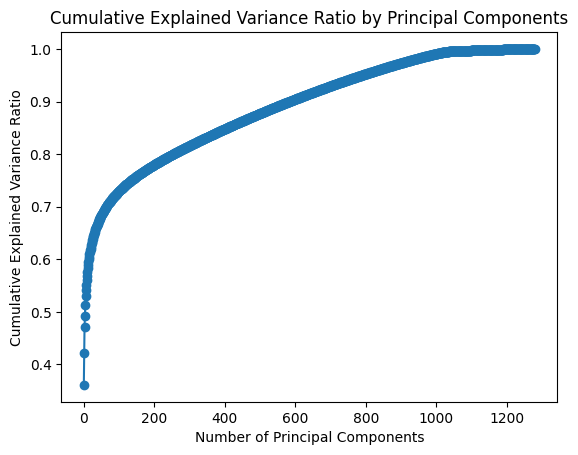

In [11]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA()
X_pca = pca.fit_transform(latent_stack)

# Explained variance
explained_variance = pca.explained_variance_
total_explained_variance = explained_variance.sum()

explained_variance_ratio = pca.explained_variance_ratio_

# Plot explained variance ratio
cumulative_variance_ratio = np.cumsum(explained_variance_ratio)
plt.plot(cumulative_variance_ratio, marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio by Principal Components')
plt.show()

In [13]:
# First index with explaned variance above 90%
n_components = np.argmax(np.cumsum(explained_variance_ratio) > 0.8)
print(n_components)

254


In [14]:
from sklearn.decomposition import PCA

pca = PCA(n_components=n_components)

reduced_latent = pca.fit_transform(latent_stack)

In [15]:
import pickle


with open("pca.pkl", "wb") as f:
    pickle.dump(pca, f)

In [16]:
import umap

In [17]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(reduced_latent)

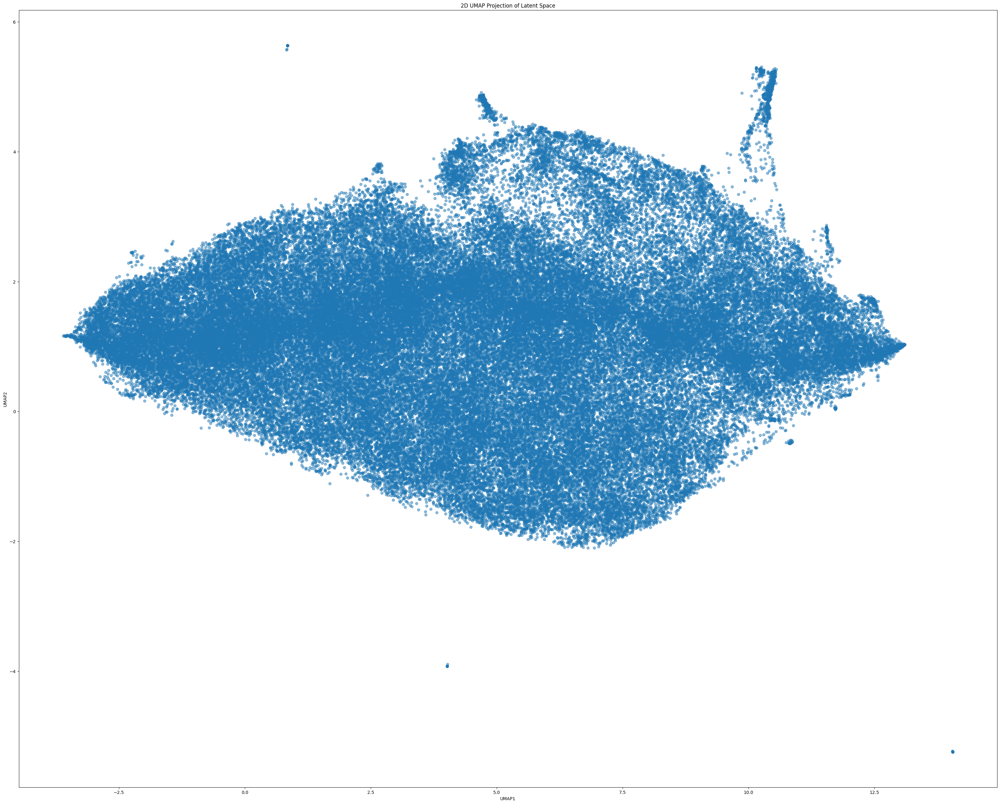

In [18]:
plt.figure(figsize=(40, 32))
plt.scatter(embedding[:, 0], embedding[:, 1], alpha=0.5)
plt.title('2D UMAP Projection of Latent Space')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.show()

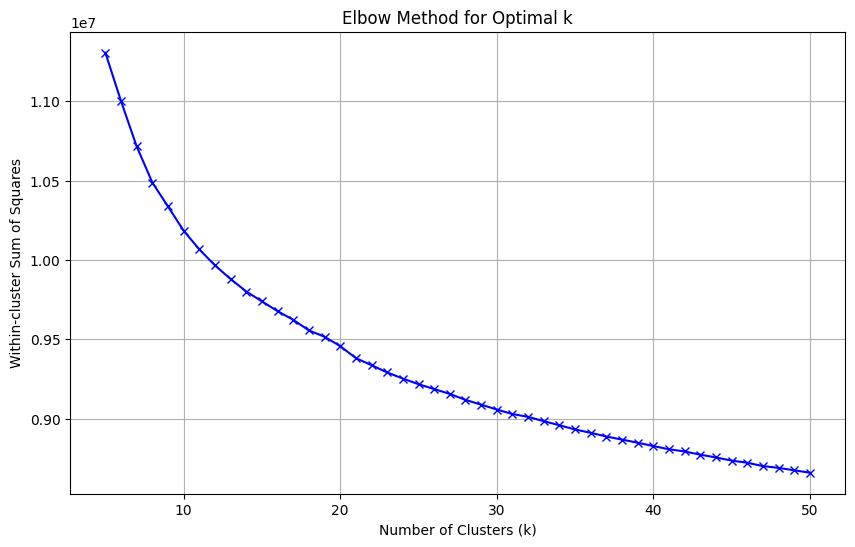


WCSS values:
k=5: 11305210.25
k=6: 11000050.85
k=7: 10714550.67
k=8: 10487165.58
k=9: 10336482.66
k=10: 10183744.33
k=11: 10066172.18
k=12: 9965341.10
k=13: 9879313.71
k=14: 9800726.28
k=15: 9738738.17
k=16: 9677038.63
k=17: 9622295.20
k=18: 9555671.89
k=19: 9515606.03
k=20: 9456646.88
k=21: 9381150.04
k=22: 9336772.27
k=23: 9290732.08
k=24: 9252569.53
k=25: 9216879.74
k=26: 9186179.88
k=27: 9155807.02
k=28: 9118144.90
k=29: 9087963.37
k=30: 9057414.76
k=31: 9028915.92
k=32: 9011343.41
k=33: 8983901.92
k=34: 8958361.74
k=35: 8931718.76
k=36: 8910490.95
k=37: 8887326.93
k=38: 8867920.20
k=39: 8848092.97
k=40: 8827132.93
k=41: 8806989.98
k=42: 8793078.47
k=43: 8773028.37
k=44: 8755227.90
k=45: 8735654.49
k=46: 8722016.81
k=47: 8700954.46
k=48: 8689760.22
k=49: 8674476.09
k=50: 8659243.34


In [19]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

def plot_elbow(data, max_clusters=50):
    wcss = []  # Within-cluster sum of squares
    K = range(5, max_clusters + 1)
    
    # Calculate WCSS for different numbers of clusters
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        wcss.append(kmeans.inertia_)
    
    # Create elbow plot
    plt.figure(figsize=(10, 6))
    plt.plot(K, wcss, 'bx-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Within-cluster Sum of Squares')
    plt.title('Elbow Method for Optimal k')
    plt.grid(True)
    plt.show()
    
    # Print WCSS values for detailed analysis
    print("\nWCSS values:")
    for k, inertia in zip(K, wcss):
        print(f"k={k}: {inertia:.2f}")

plot_elbow(reduced_latent)

In [20]:
def kmeans_and_umap(data, n_clusters):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(data)
    centers = kmeans.cluster_centers_

    plt.figure(figsize=(40, 32))
    
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], 
                            c=labels, cmap='viridis', 
                            alpha=0.5, s=100)

    plt.title('2D UMAP Projection with Cluster Labels')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.show()

    return kmeans, labels, centers

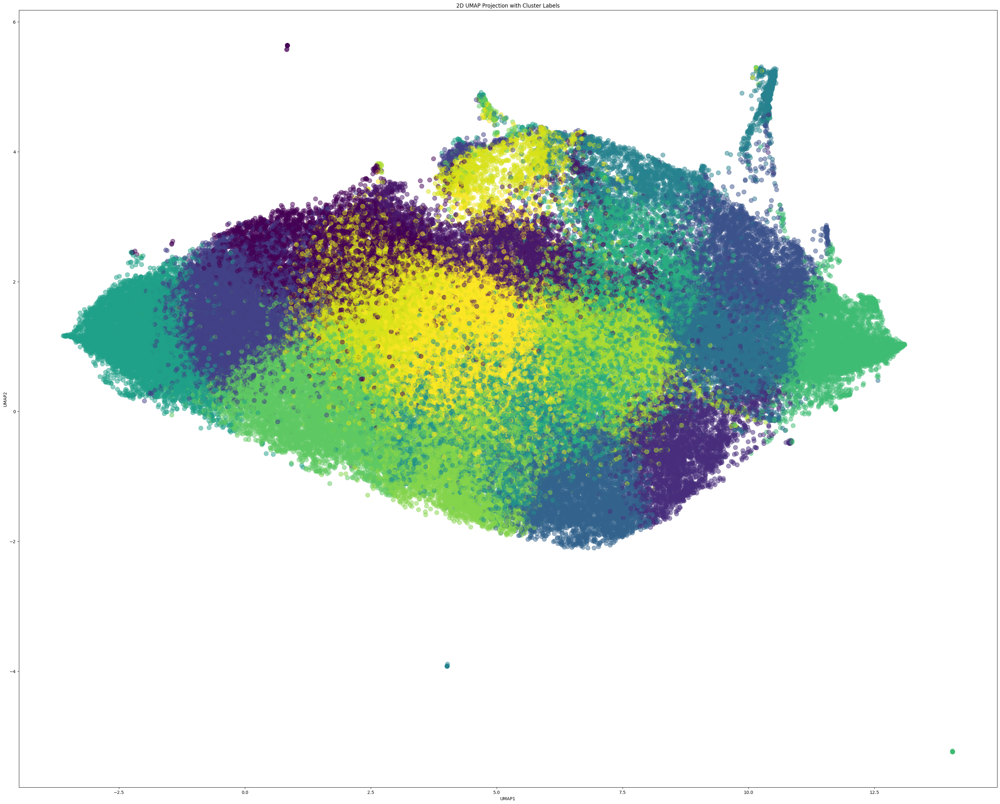

In [21]:
model, labels, centers = kmeans_and_umap(reduced_latent, 17)

In [22]:
from sklearn.preprocessing import LabelEncoder

real_labels = dataset.dataset["genre"]

label_encoder = LabelEncoder()

real_labels = label_encoder.fit_transform(real_labels)


In [23]:
all(idx_list[i] <= idx_list[i+1] for i in range(len(idx_list) - 1))

True

In [24]:
np.unique(style_labels) # genres actually

array(['None', 'abstract', 'advertisement', 'allegorical painting',
       'animal painting', 'battle painting', 'bijinga',
       'bird-and-flower painting', 'calligraphy', 'capriccio',
       'caricature', 'cityscape', 'cloudscape', 'design', 'figurative',
       'flower painting', 'genre painting', 'history painting',
       'illustration', 'interior', 'landscape', 'literary painting',
       'marina', 'miniature', 'mythological painting',
       'nude painting (nu)', 'panorama', 'pastorale', 'portrait',
       'poster', 'quadratura', 'religious painting', 'self-portrait',
       'shan shui', 'sketch and study', 'still life', 'symbolic painting',
       'tessellation', 'urushi-e', 'vanitas', 'veduta',
       'wildlife painting', 'yakusha-e'], dtype='<U24')

In [25]:
import pandas as pd

df = pd.DataFrame({
    "idx": idx_list,
    "cluster": labels
})

In [26]:
df.to_csv("./image_label_dict.csv", index=False)

In [27]:
import pickle


# save kmeans model
with open("kmeans.pkl", "wb") as f:
    pickle.dump(model, f)

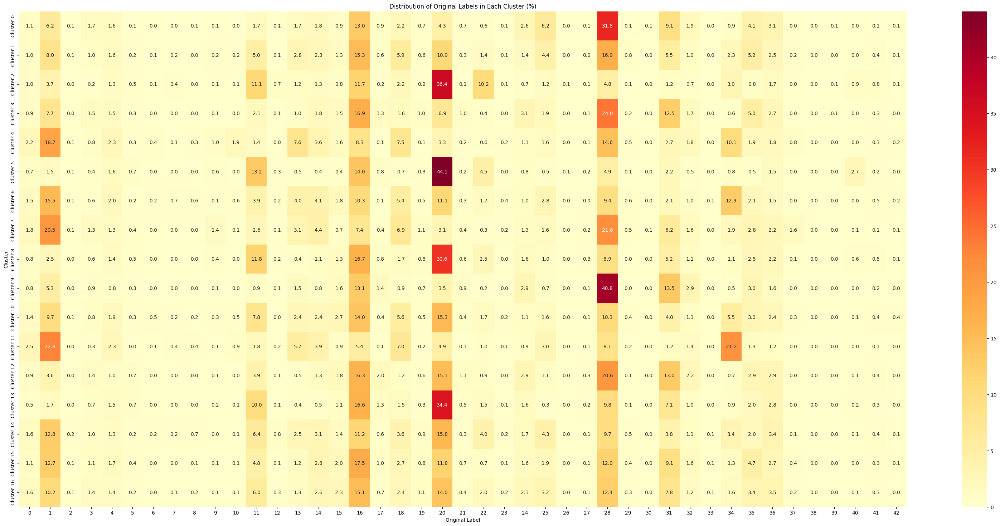


Detailed Cluster Compositions:

Cluster 0 (Total size: 5405)
  28: 1720 (31.82%)
  16: 705 (13.04%)
  31: 490 (9.07%)
  25: 337 (6.23%)
  1: 336 (6.22%)
  20: 233 (4.31%)
  35: 221 (4.09%)
  36: 168 (3.11%)
  24: 143 (2.65%)
  18: 117 (2.16%)
  32: 100 (1.85%)
  14: 97 (1.79%)
  3: 92 (1.7%)
  13: 91 (1.68%)
  11: 90 (1.67%)
  4: 85 (1.57%)
  0: 57 (1.05%)
  17: 50 (0.93%)
  15: 48 (0.89%)
  34: 46 (0.85%)
  21: 37 (0.68%)
  19: 36 (0.67%)
  22: 35 (0.65%)
  5: 8 (0.15%)
  9: 8 (0.15%)
  29: 8 (0.15%)
  12: 7 (0.13%)
  8: 7 (0.13%)
  41: 7 (0.13%)
  30: 4 (0.07%)
  27: 4 (0.07%)
  23: 4 (0.07%)
  42: 4 (0.07%)
  2: 3 (0.06%)
  39: 3 (0.06%)
  40: 1 (0.02%)
  7: 1 (0.02%)
  37: 1 (0.02%)
  26: 1 (0.02%)

Cluster 1 (Total size: 4587)
  28: 774 (16.87%)
  16: 701 (15.28%)
  20: 499 (10.88%)
  1: 368 (8.02%)
  18: 269 (5.86%)
  31: 254 (5.54%)
  35: 237 (5.17%)
  11: 230 (5.01%)
  25: 202 (4.4%)
  13: 128 (2.79%)
  36: 116 (2.53%)
  14: 106 (2.31%)
  34: 106 (2.31%)
  4: 72 (1.57%)
  22: 

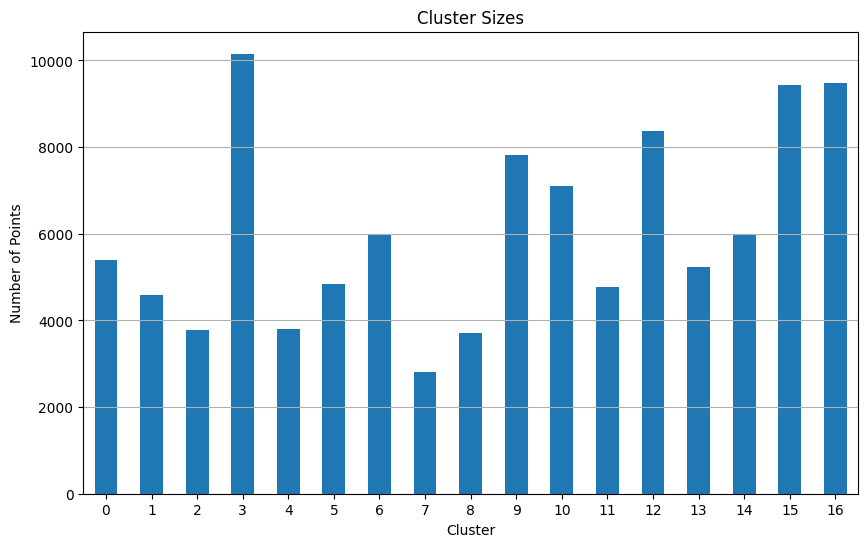

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import Counter

def analyze_cluster_compositions(cluster_labels, original_labels):
    """
    Analyze and visualize the composition of each cluster in terms of original labels
    
    Parameters:
    -----------
    cluster_labels : array-like
        The cluster assignments from k-means
    original_labels : array-like
        The original ground truth labels
    """
    # Create a DataFrame for easy analysis
    df = pd.DataFrame({
        'Cluster': cluster_labels,
        'Original_Label': original_labels
    })
    
    # Get cluster compositions
    compositions = {}
    for cluster in np.unique(cluster_labels):
        mask = df['Cluster'] == cluster
        cluster_composition = Counter(df[mask]['Original_Label'])
        compositions[f'Cluster {cluster}'] = cluster_composition
    
    # Create a matrix of label distributions
    unique_labels = sorted(set(original_labels))
    distribution_matrix = np.zeros((len(compositions), len(unique_labels)))
    
    for i, (cluster, comp) in enumerate(compositions.items()):
        total = sum(comp.values())
        for j, label in enumerate(unique_labels):
            distribution_matrix[i, j] = comp.get(label, 0) / total * 100

    # Plot heatmap
    plt.figure(figsize=(40, 18))
    sns.heatmap(distribution_matrix,
                xticklabels=unique_labels,
                yticklabels=compositions.keys(),
                annot=True,
                fmt='.1f',
                cmap='YlOrRd')
    plt.title('Distribution of Original Labels in Each Cluster (%)')
    plt.xlabel('Original Label')
    plt.ylabel('Cluster')
    plt.show()

    # Print detailed statistics
    print("\nDetailed Cluster Compositions:")
    for cluster in np.unique(cluster_labels):
        mask = df['Cluster'] == cluster
        cluster_size = mask.sum()
        print(f"\nCluster {cluster} (Total size: {cluster_size})")
        composition = df[mask]['Original_Label'].value_counts()
        percentages = (composition / cluster_size * 100).round(2)
        for label, count in composition.items():
            print(f"  {label}: {count} ({percentages[label]}%)")

    # Plot cluster sizes
    plt.figure(figsize=(10, 6))
    cluster_sizes = df['Cluster'].value_counts().sort_index()
    cluster_sizes.plot(kind='bar')
    plt.title('Cluster Sizes')
    plt.xlabel('Cluster')
    plt.ylabel('Number of Points')
    plt.xticks(rotation=0)
    plt.grid(True, axis='y')
    plt.show()

analyze_cluster_compositions(labels, real_labels)

In [29]:
from collections import defaultdict

def get_random_indices_per_cluster(cluster_labels, n_per_cluster):
    cluster_indices = defaultdict(list)
    for idx, label in enumerate(cluster_labels):
        cluster_indices[label].append(idx)
    
    cluster_indices = {k: np.array(v) for k, v in cluster_indices.items()}
    
    sampled_indices = {}
    for cluster in cluster_indices:
        n_samples = min(n_per_cluster, len(cluster_indices[cluster]))
        sampled_indices[cluster] = np.random.choice(
            cluster_indices[cluster], 
            size=n_samples, 
            replace=False
        )
    
    return sampled_indices

In [30]:
cluster_examples = get_random_indices_per_cluster(labels, 16)

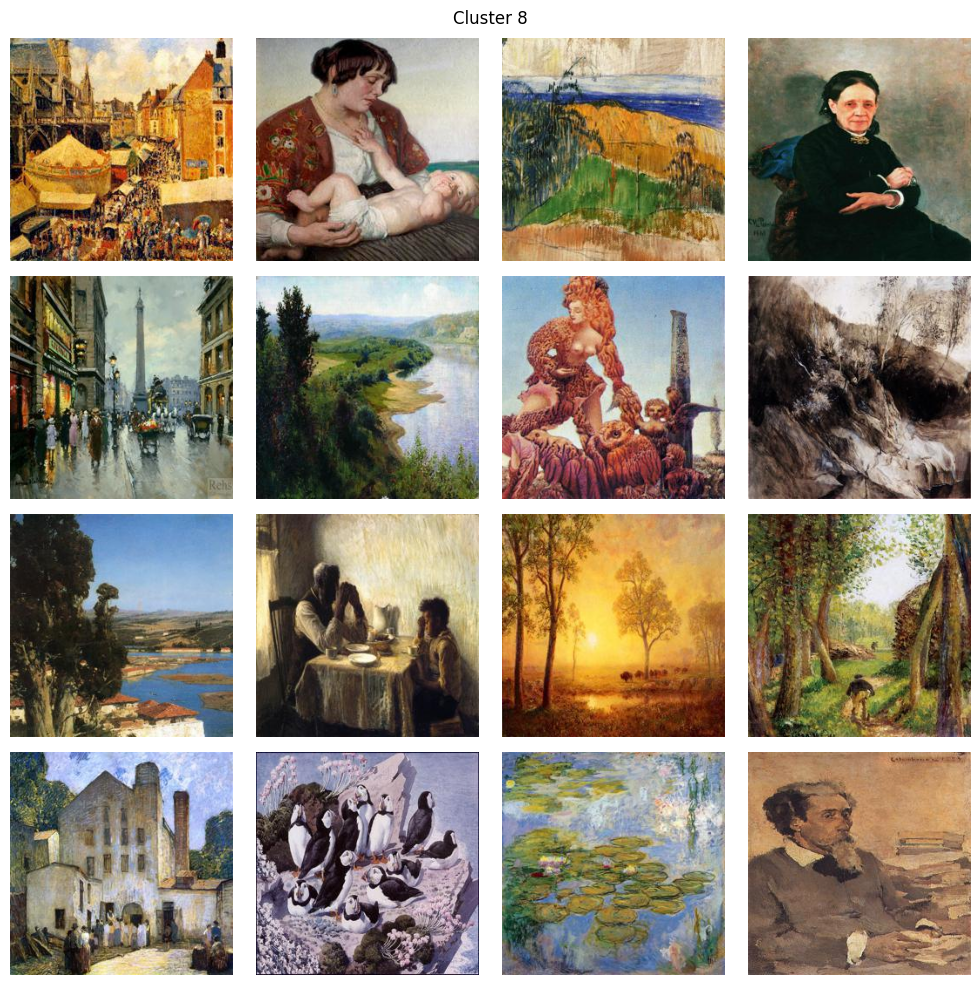

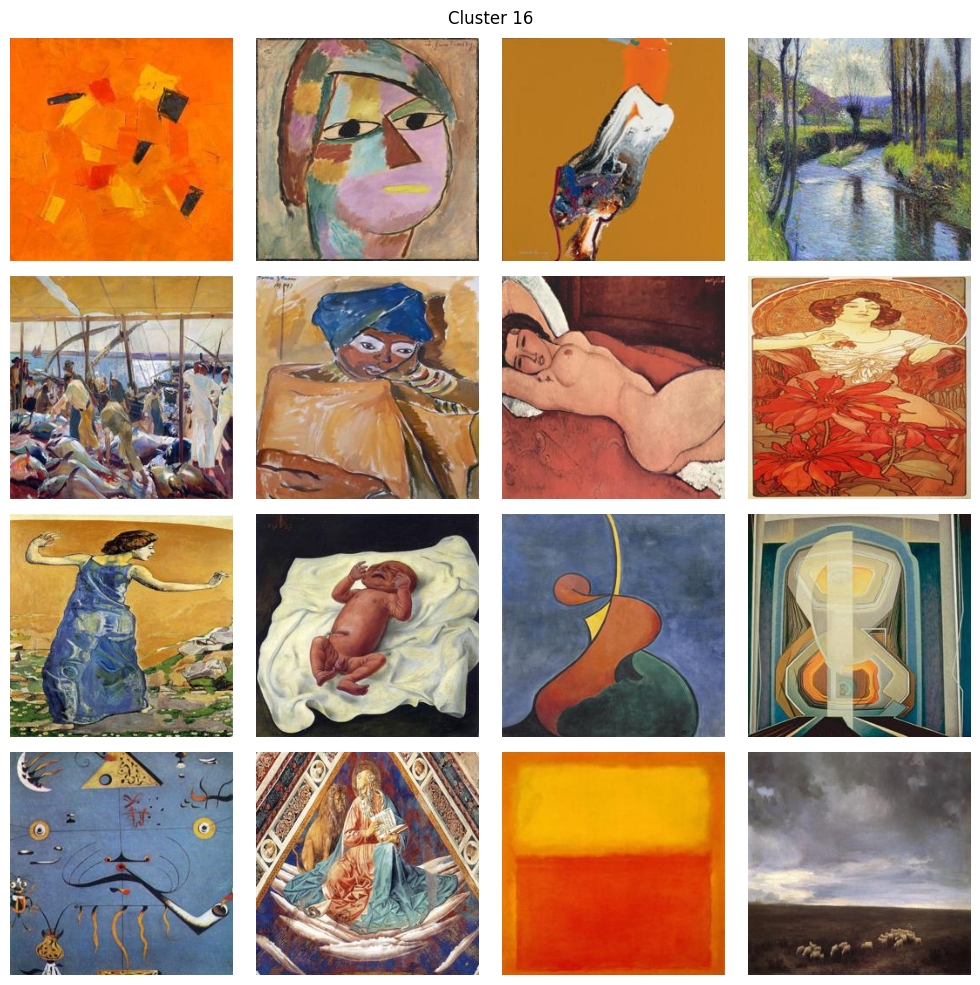

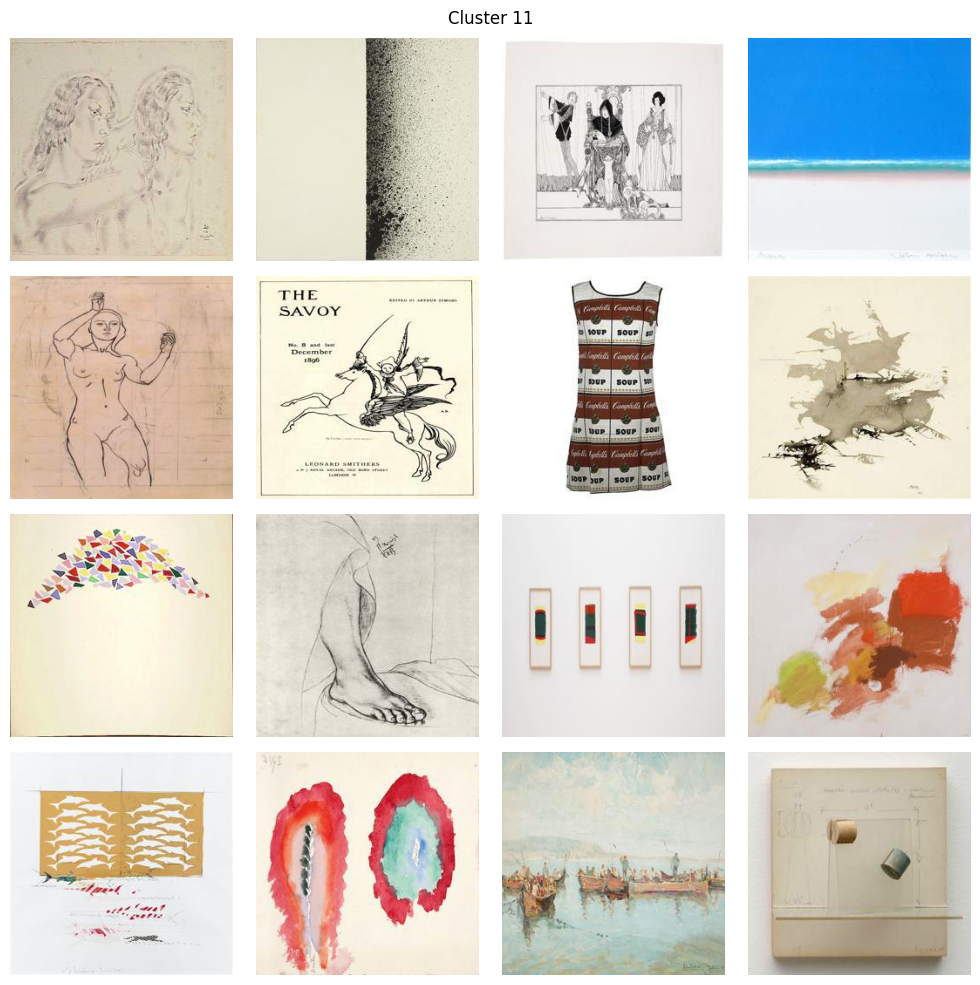

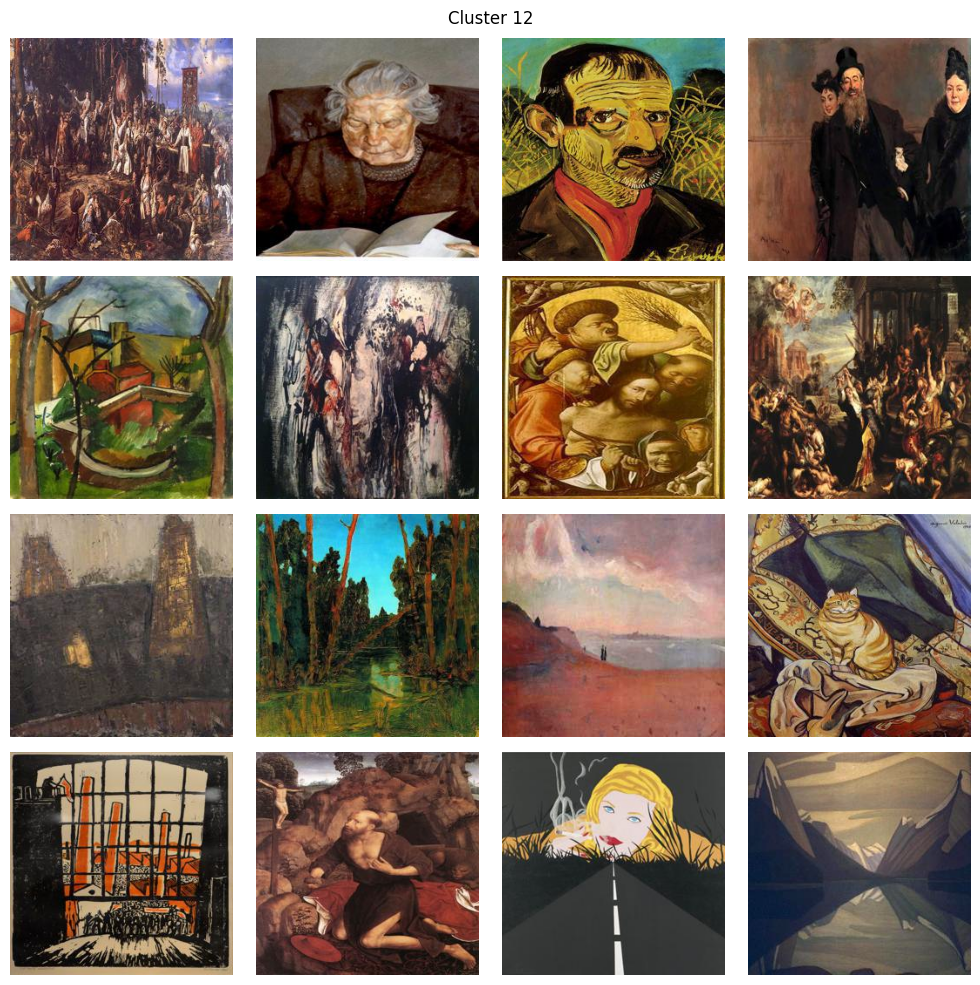

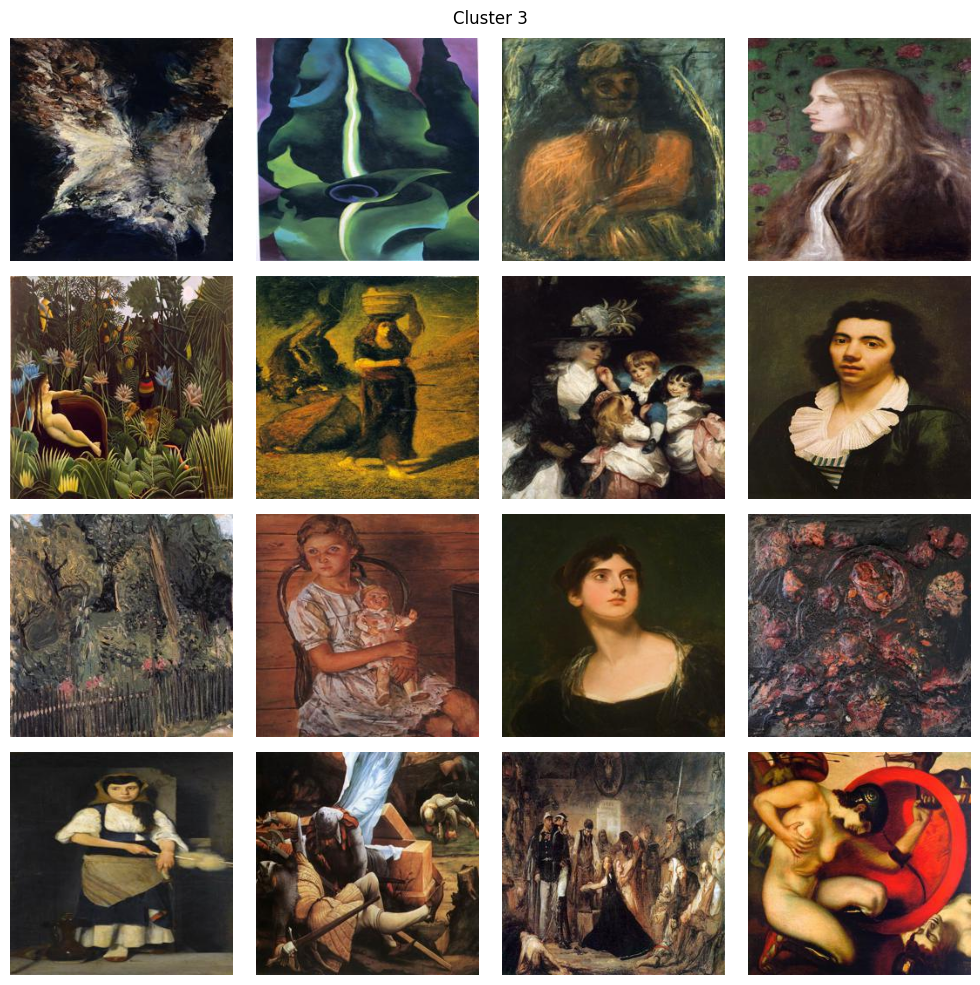

...

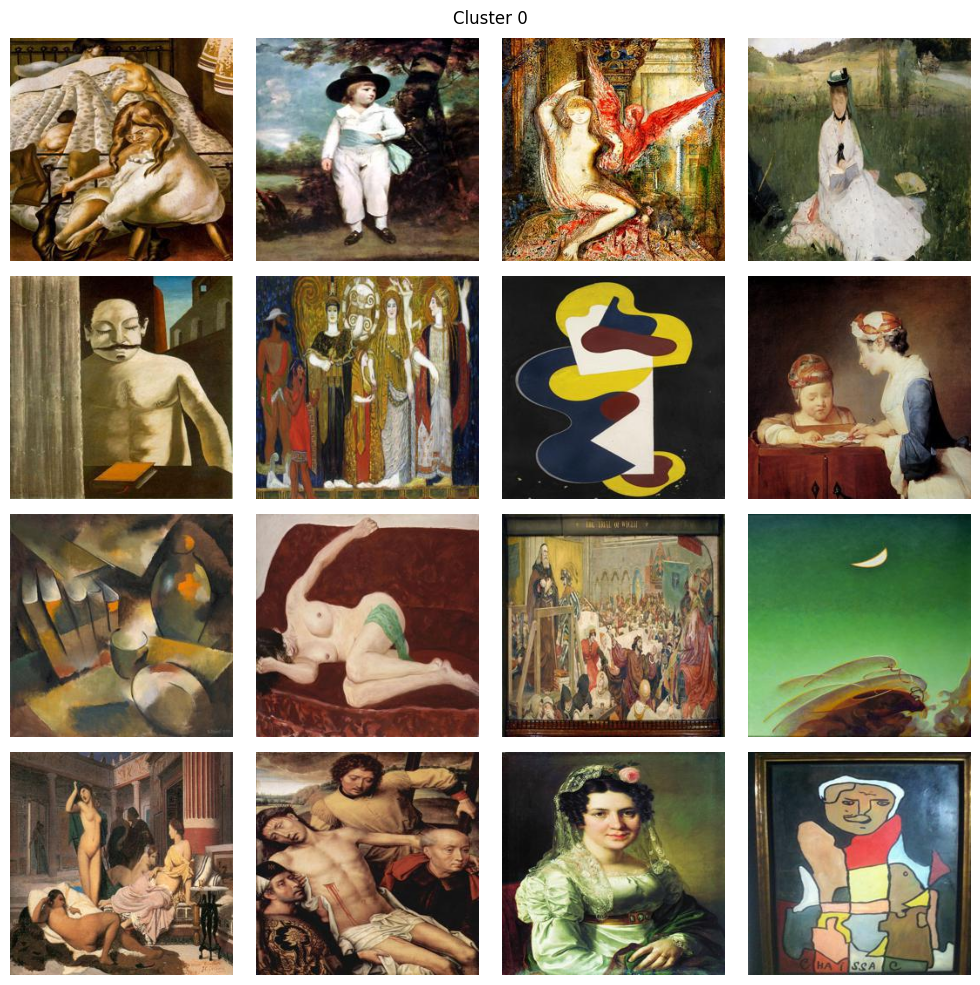

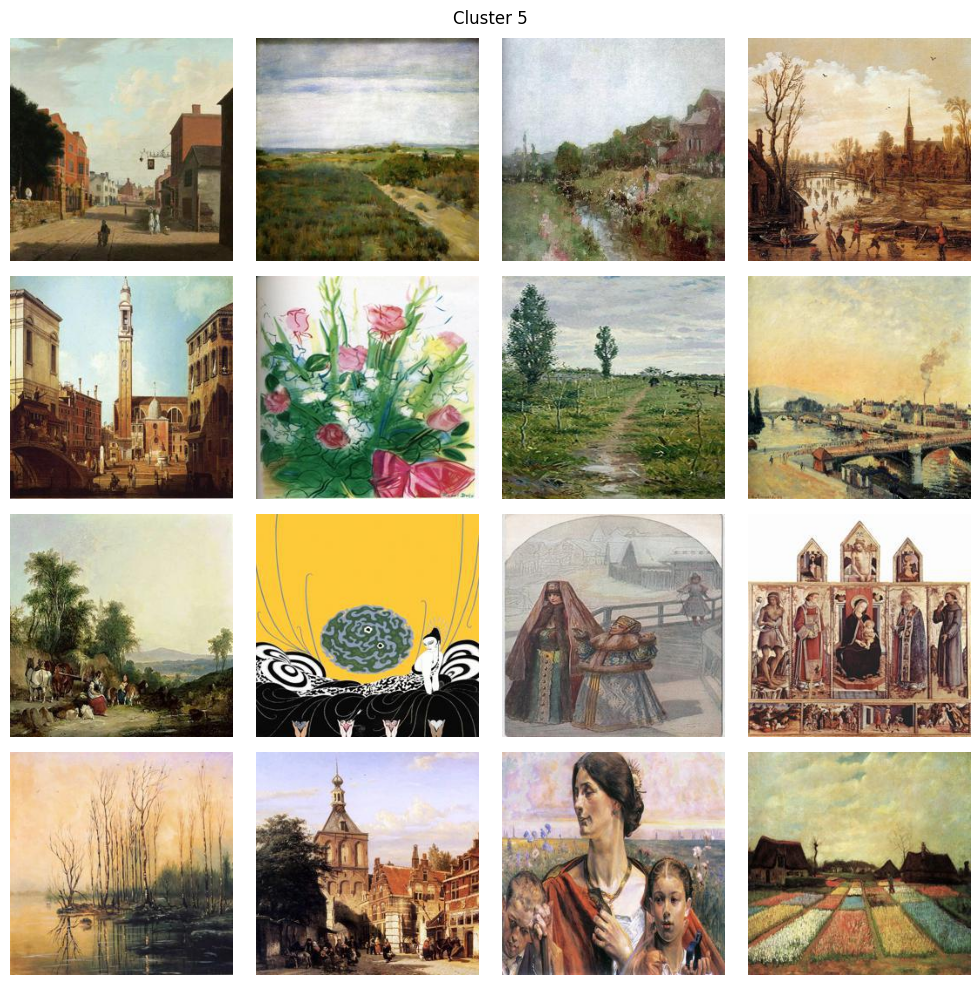

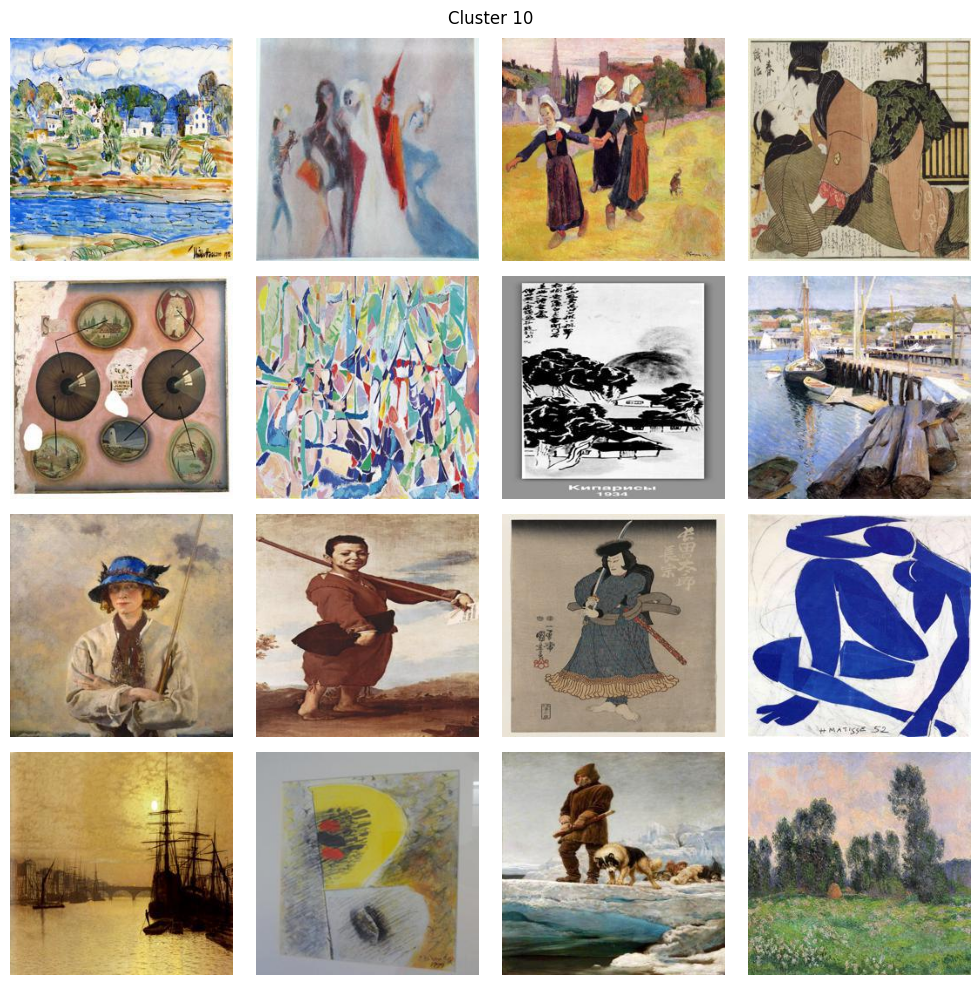

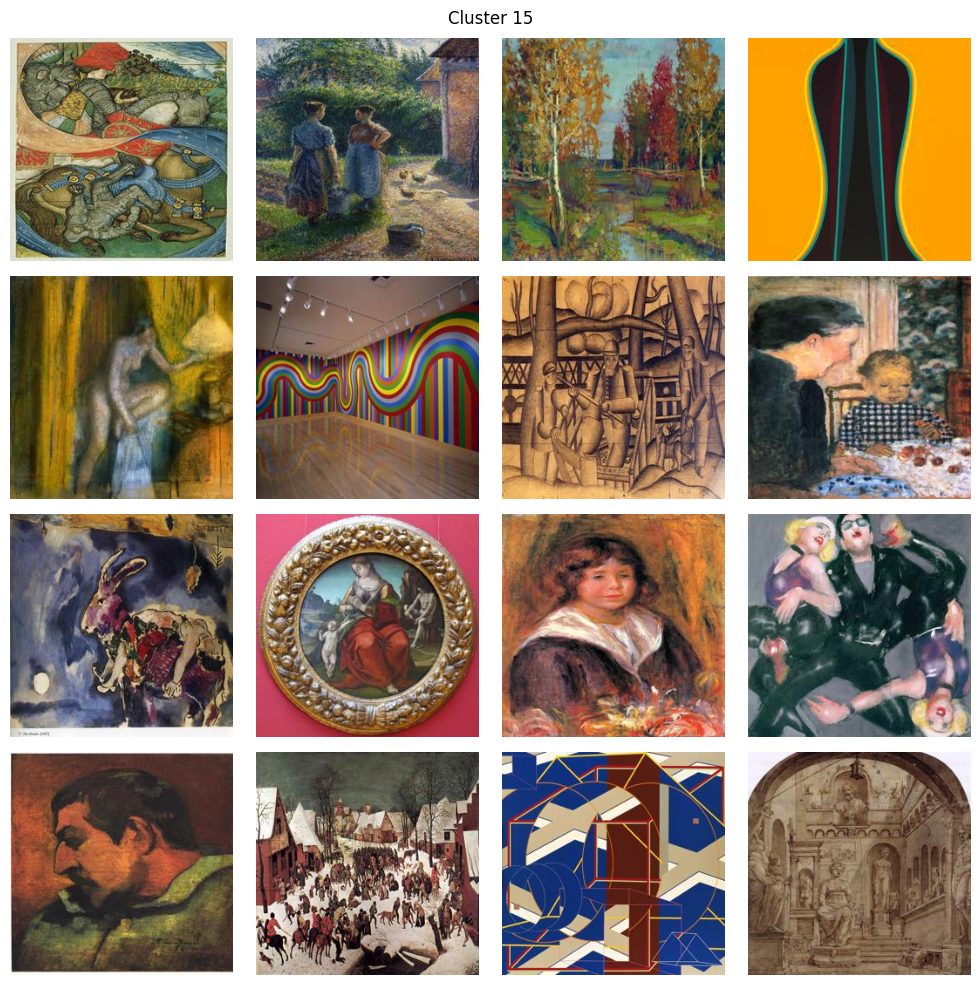

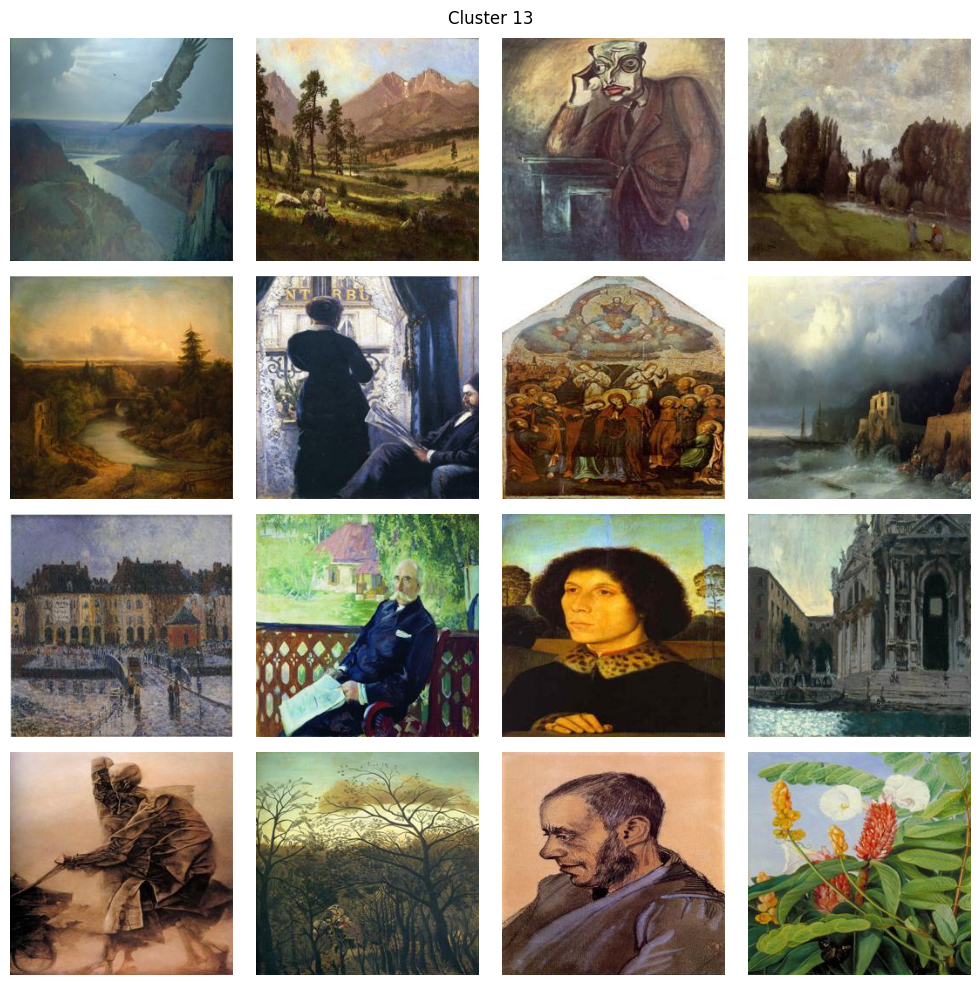

In [31]:
for cluster_idx, indices in cluster_examples.items():
    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
        
    axes_flat = axes.flatten()

    for i, ax in enumerate(axes_flat):
        if i < len(indices):
            img = dataset[int(indices[i])][0].permute(1, 2, 0)
            img = (img - img.min()) / (img.max() - img.min()) * 255
            img = img.to(torch.uint8)
            ax.axis('off')  # Turn off axes
            ax.imshow(img)
        plt.suptitle(f"Cluster {cluster_idx}")

    plt.tight_layout()
    plt.show()